Full image dimensions: 16091 x 18457

Band value ranges after scaling:
Green: 0.0000 to 0.1945
Red: 0.0000 to 0.1867
NIR: 0.0000 to 0.3470

Region of Interest: x(4100-13000), y(400-15000)
ROI dimensions: 14600 x 8900


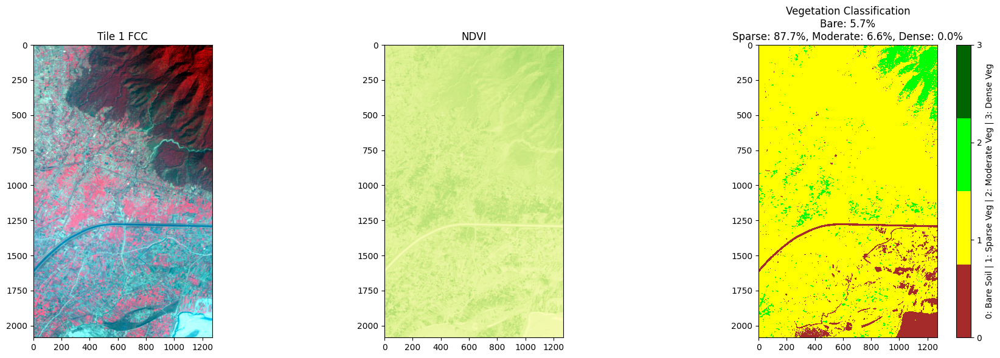

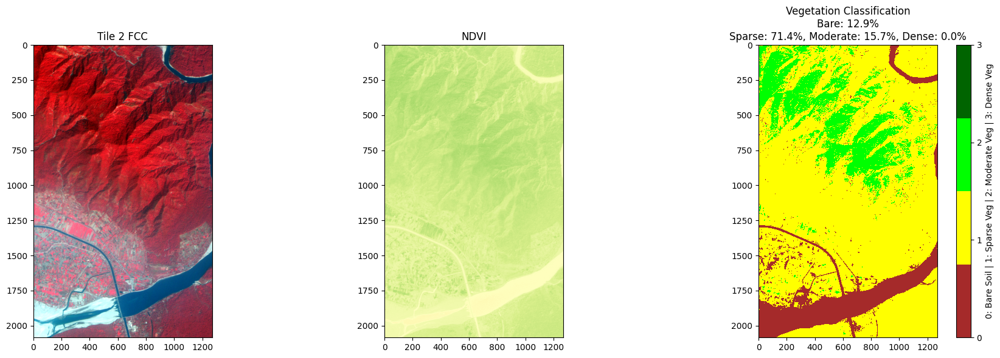

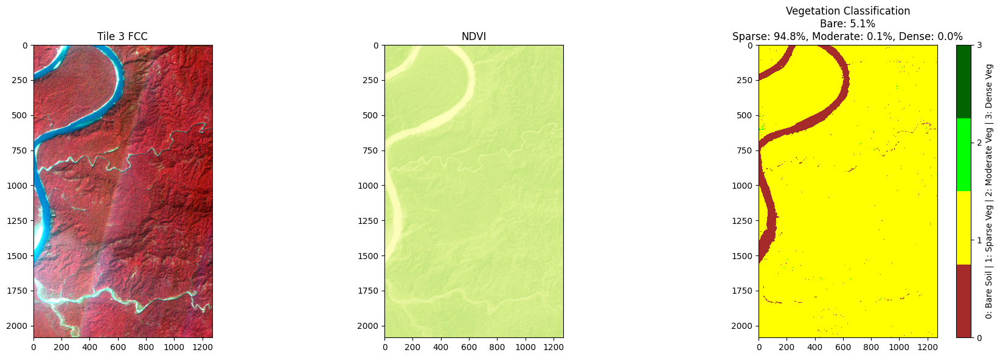

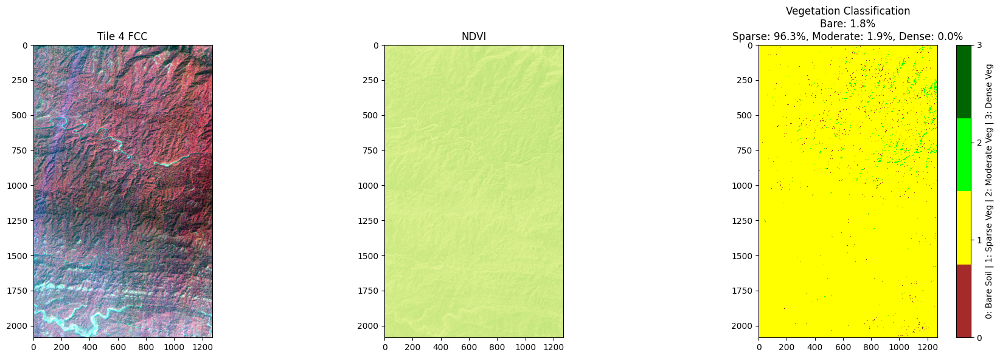

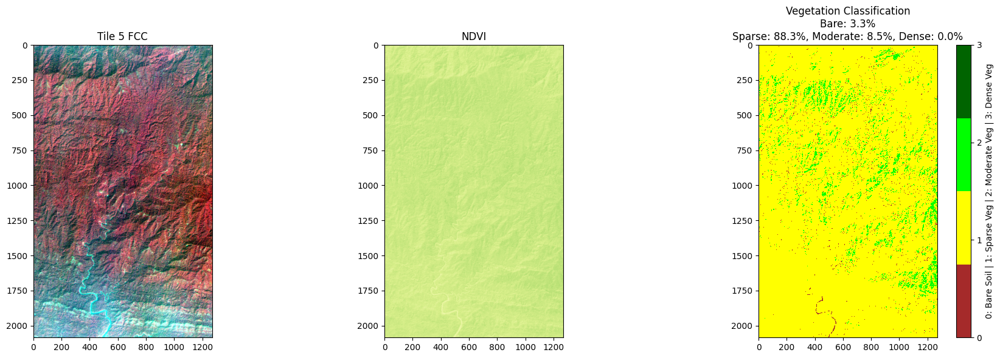

...

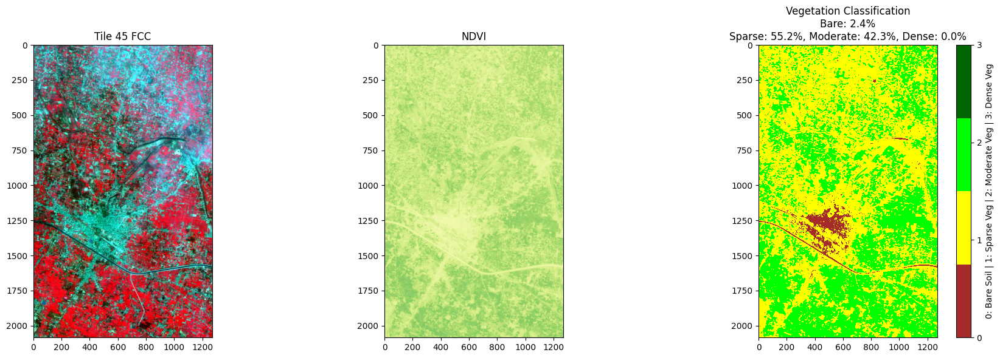

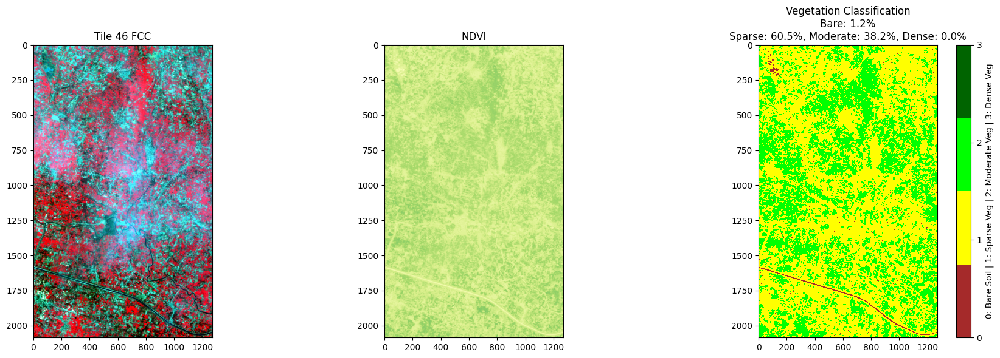

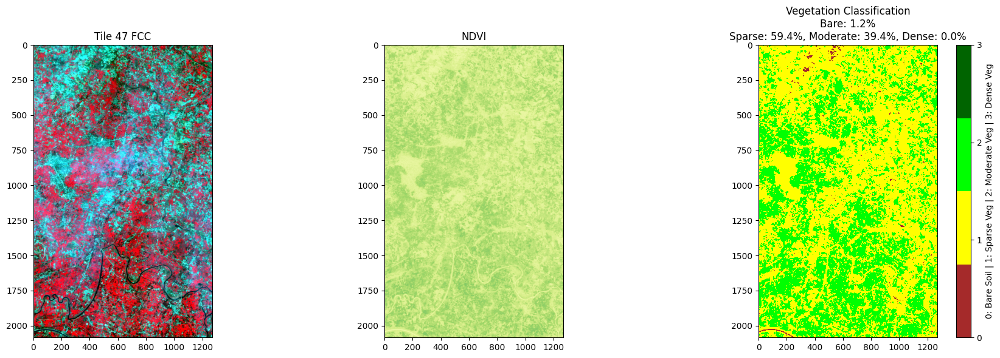

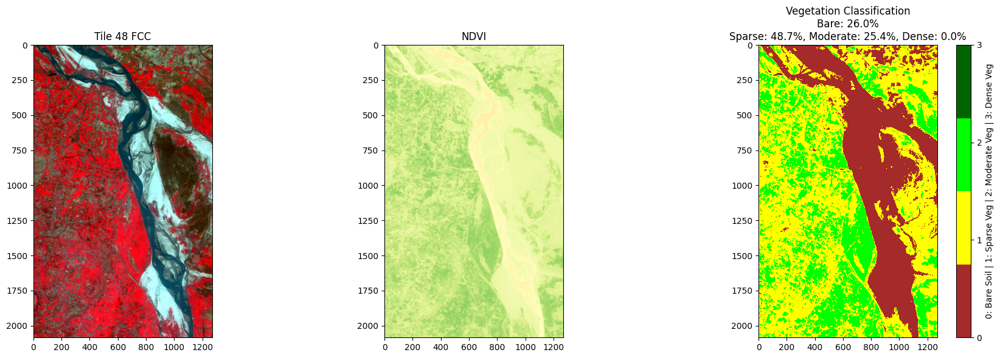

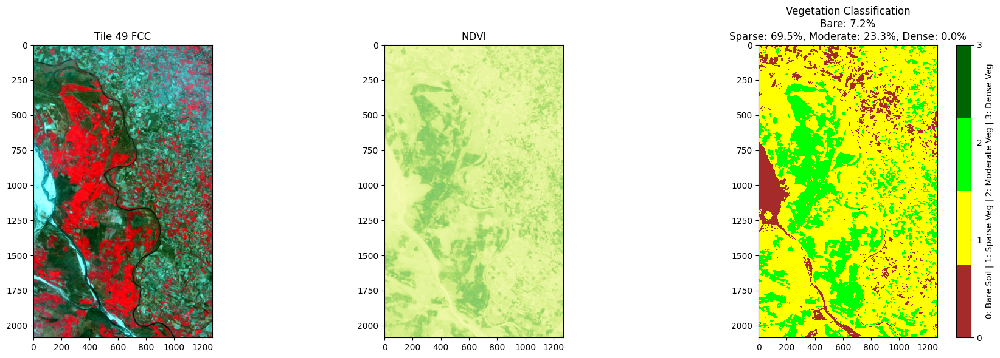


Vegetation Classification Summary:
Bare Soil:
  Average: 8.85%
  Maximum: 38.06%
  Minimum: 0.88%
  Std Dev: 10.01%
Sparse Veg:
  Average: 75.77%
  Maximum: 96.28%
  Minimum: 48.68%
  Std Dev: 12.68%
Moderate Veg:
  Average: 15.38%
  Maximum: 42.31%
  Minimum: 0.14%
  Std Dev: 10.86%
Dense Veg:
  Average: 0.00%
  Maximum: 0.00%
  Minimum: 0.00%
  Std Dev: 0.00%

Top 5 Most Vegetated Tiles:
Tile 1: 0.0% dense vegetation at (4100, 400, 5371, 2485)
  Moderate: 6.6%, Sparse: 87.7%
  Bare soil: 5.7%
Tile 2: 0.0% dense vegetation at (5371, 400, 6642, 2485)
  Moderate: 15.7%, Sparse: 71.4%
  Bare soil: 12.9%
Tile 3: 0.0% dense vegetation at (6642, 400, 7913, 2485)
  Moderate: 0.1%, Sparse: 94.8%
  Bare soil: 5.1%
Tile 4: 0.0% dense vegetation at (7913, 400, 9184, 2485)
  Moderate: 1.9%, Sparse: 96.3%
  Bare soil: 1.8%
Tile 5: 0.0% dense vegetation at (9184, 400, 10455, 2485)
  Moderate: 8.5%, Sparse: 88.3%
  Bare soil: 3.3%


In [12]:
import rasterio
import numpy as np
from skimage.morphology import remove_small_objects
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

def load_liss4_band(path):
    """Load and properly scale LISS-IV band (10-bit or 12-bit)"""
    with rasterio.open(path) as src:
        band = src.read(1)
        # Check if data is 10-bit (0-1023) or 12-bit (0-4095)
        max_val = 1023 if band.max() <= 1023 else 4095
        return band.astype('float32') / max_val

# Load bands
green = load_liss4_band('BAND2.tif')  # Green (0.52-0.59µm)
red = load_liss4_band('BAND3.tif')    # Red (0.62-0.68µm)
nir = load_liss4_band('BAND4.tif')    # NIR (0.77-0.86µm)

# Validate band ranges
full_height, full_width = green.shape
print(f"Full image dimensions: {full_height} x {full_width}")
print("\nBand value ranges after scaling:")
print(f"Green: {green.min():.4f} to {green.max():.4f}")
print(f"Red: {red.min():.4f} to {red.max():.4f}")
print(f"NIR: {nir.min():.4f} to {nir.max():.4f}")

# Define ROI
x_start, x_end = 4100, 13000
y_start, y_end = 400, 15000

# Validate coordinates
x_start = max(0, min(x_start, full_width))
x_end = max(x_start, min(x_end, full_width))
y_start = max(0, min(y_start, full_height))
y_end = max(y_start, min(y_end, full_height))

print(f"\nRegion of Interest: x({x_start}-{x_end}), y({y_start}-{y_end})")

# Extract ROI
green_roi = green[y_start:y_end, x_start:x_end]
red_roi = red[y_start:y_end, x_start:x_end]
nir_roi = nir[y_start:y_end, x_start:x_end]

roi_height, roi_width = green_roi.shape
print(f"ROI dimensions: {roi_height} x {roi_width}")

def vegetation_classification(red_tile, nir_tile, min_size=10):
    """
    Vegetation classification using NDVI with:
    - NDVI calculation
    - Classification of vegetation density levels
    - Bare soil identification
    """
    # Calculate NDVI
    ndvi = (nir_tile - red_tile) / (nir_tile + red_tile + 1e-10)
    
    # Classify features based on NDVI thresholds (adjusted for vegetation only)
    dense_vegetation = ndvi > 0.6
    moderate_vegetation = (ndvi > 0.3) & (ndvi <= 0.6)
    sparse_vegetation = (ndvi > 0.1) & (ndvi <= 0.3)
    bare_soil = ndvi <= 0.1  # Everything below sparse vegetation threshold
    
    # Remove small objects from each class
    dense_veg_clean = remove_small_objects(dense_vegetation, min_size=min_size)
    mod_veg_clean = remove_small_objects(moderate_vegetation, min_size=min_size)
    sparse_veg_clean = remove_small_objects(sparse_vegetation, min_size=min_size)
    bare_soil_clean = remove_small_objects(bare_soil, min_size=min_size)
    
    # Create classified image (for visualization)
    classified = np.zeros_like(ndvi, dtype=np.uint8)
    classified[dense_veg_clean] = 3      # Dense vegetation
    classified[mod_veg_clean] = 2       # Moderate vegetation
    classified[sparse_veg_clean] = 1    # Sparse vegetation
    classified[bare_soil_clean] = 0     # Bare soil
    
    return classified, ndvi

def scale_for_display(img, percentile=98):
    """Enhanced contrast stretching for visualization"""
    img = np.nan_to_num(img, nan=0.0)
    p2, p98 = np.percentile(img[img > 0], (2, percentile))
    return np.clip((img - p2) / (p98 - p2), 0, 1)

# Process tiles
rows, cols = 7, 7
tile_height = roi_height // rows
tile_width = roi_width // cols

veg_stats = []
tile_info = []

# Main processing loop
for i in range(rows):
    for j in range(cols):
        tile_idx = i * cols + j + 1
        
        # Extract tile
        y1, y2 = i * tile_height, (i + 1) * tile_height
        x1, x2 = j * tile_width, (j + 1) * tile_width
        green_tile = green_roi[y1:y2, x1:x2]
        red_tile = red_roi[y1:y2, x1:x2]
        nir_tile = nir_roi[y1:y2, x1:x2]
        
        # Classify vegetation
        classified, ndvi = vegetation_classification(red_tile, nir_tile)
        
        # Calculate percentages
        total_pixels = classified.size
        bare_pct = np.sum(classified == 0) / total_pixels * 100
        sparse_pct = np.sum(classified == 1) / total_pixels * 100
        moderate_pct = np.sum(classified == 2) / total_pixels * 100
        dense_pct = np.sum(classified == 3) / total_pixels * 100
        
        # Store results
        veg_stats.append({
            'bare_soil': bare_pct,
            'sparse_veg': sparse_pct,
            'moderate_veg': moderate_pct,
            'dense_veg': dense_pct
        })
        
        tile_info.append({
            'tile': tile_idx,
            'bare_pct': bare_pct,
            'sparse_pct': sparse_pct,
            'moderate_pct': moderate_pct,
            'dense_pct': dense_pct,
            'coords': (x_start + x1, y_start + y1, x_start + x2, y_start + y2)
        })
        
        # Visualization
        fcc = np.dstack((scale_for_display(nir_tile), 
                        scale_for_display(red_tile), 
                        scale_for_display(green_tile)))
        
        # Create custom colormap for classified image (without water)
        cmap = ListedColormap(['brown', 'yellow', 'lime', 'darkgreen'])
        
        plt.figure(figsize=(18, 6))
        plt.subplot(131); plt.imshow(fcc); plt.title(f'Tile {tile_idx} FCC')
        plt.subplot(132); plt.imshow(ndvi, cmap='RdYlGn', vmin=-1, vmax=1); plt.title('NDVI')
        plt.subplot(133); plt.imshow(classified, cmap=cmap, vmin=0, vmax=3)
        plt.title('Vegetation Classification\nBare: {:.1f}%\nSparse: {:.1f}%, Moderate: {:.1f}%, Dense: {:.1f}%'.format(
            bare_pct, sparse_pct, moderate_pct, dense_pct))
        plt.colorbar(ticks=[0, 1, 2, 3], label='0: Bare Soil | 1: Sparse Veg | 2: Moderate Veg | 3: Dense Veg')
        plt.tight_layout()
        plt.show()

# Summary statistics
def print_statistics(feature, stats):
    values = [tile[feature] for tile in veg_stats]
    print(f"{feature.replace('_', ' ').title()}:")
    print(f"  Average: {np.mean(values):.2f}%")
    print(f"  Maximum: {np.max(values):.2f}%")
    print(f"  Minimum: {np.min(values):.2f}%")
    print(f"  Std Dev: {np.std(values):.2f}%")

print("\nVegetation Classification Summary:")
print_statistics('bare_soil', veg_stats)
print_statistics('sparse_veg', veg_stats)
print_statistics('moderate_veg', veg_stats)
print_statistics('dense_veg', veg_stats)

# Sort tiles by vegetation density
sorted_tiles = sorted(tile_info, key=lambda x: x['dense_pct'], reverse=True)
print("\nTop 5 Most Vegetated Tiles:")
for tile in sorted_tiles[:5]:
    print(f"Tile {tile['tile']}: {tile['dense_pct']:.1f}% dense vegetation at {tile['coords']}")
    print(f"  Moderate: {tile['moderate_pct']:.1f}%, Sparse: {tile['sparse_pct']:.1f}%")
    print(f"  Bare soil: {tile['bare_pct']:.1f}%")